# Web Scraping

Web scraping using the Beautiful Soup package is a powerful technique in the field of web data extraction and parsing. Beautiful Soup is a Python library that makes it easy to scrape and navigate through HTML and XML documents, extracting specific information from web pages. 

It is commonly used for various purposes, such as data collection, web content analysis, automation of repetitive tasks, and more. Beautiful Soup provides a convenient way to search, filter, and manipulate the elements of a web page, allowing you to extract structured data from unstructured web content.

The key features of Beautiful Soup include:

1. **Parsing HTML and XML:** Beautiful Soup parses HTML and XML documents and creates a parse tree, making it easy to navigate and extract data from web pages.

2. **Search and Navigation:** You can search for elements by tag name, attributes, or text content, and navigate through the document's structure.

3. **Data Extraction:** Beautiful Soup allows you to extract specific data points, such as text, links, images, and more from a web page.

4. **Robustness:** It handles malformed HTML gracefully, making it suitable for scraping websites with varying degrees of markup quality.

5. **Integration:** Beautiful Soup is often used in conjunction with other libraries, such as Requests for making HTTP requests and Pandas for data manipulation, to create comprehensive web scraping workflows.

However, it's important to note that web scraping should be done responsibly and in accordance with the terms of service and legal requirements of the websites you're scraping. Overly aggressive or unauthorized scraping can lead to legal issues and may impact the target website's performance. Always respect website policies and consider using web scraping for ethical and legitimate purposes.

Here is an approach to try and scrape the top 250 movies data listed by the IMDB using their website : 'https://www.imdb.com/chart/top/'

In [1]:
# Importing the required packages

from bs4 import BeautifulSoup
import requests # Requests from the website for learning purpose and not for hacking


import os, sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import scipy.stats as stats
from datetime import datetime
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
sns.set()
pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns',None)
sns.set_style('whitegrid')

In [2]:
# Loading the url and header to request access from the site

url = 'https://www.imdb.com/chart/top/'
headers = {
    "User-Agent": "Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/58.0.3029.110 Safari/537.36"
}

html = requests.get(url, headers=headers)
print(url)
print(html)

https://www.imdb.com/chart/top/
<Response [200]>


In [3]:
# Using BeautifulSoup to extract the HTML data

bsobj = BeautifulSoup(html.text, 'lxml')
bsobj

<!DOCTYPE html>
<html lang="en-US" xmlns:fb="http://www.facebook.com/2008/fbml" xmlns:og="http://opengraphprotocol.org/schema/"><head><meta charset="utf-8"/><meta content="width=device-width" name="viewport"/><script>if(typeof uet === 'function'){ uet('bb', 'LoadTitle', {wb: 1}); }</script><script>window.addEventListener('load', (event) => {
        if (typeof window.csa !== 'undefined' && typeof window.csa === 'function') {
            var csaLatencyPlugin = window.csa('Content', {
                element: {
                    slotId: 'LoadTitle',
                    type: 'service-call'
                }
            });
            csaLatencyPlugin('mark', 'clickToBodyBegin', 1698044790674);
        }
    })</script><title>IMDb Top 250 Movies</title><meta content="As rated by regular IMDb voters." data-id="main" name="description"/><meta content="IMDb" property="og:site_name"/><meta content="IMDb Top 250 Movies" property="og:title"/><meta content="As rated by regular IMDb voters." p

In [4]:
# Getting the header in the HTML Format

bsobj.findAll('h1')

[<h1 class="ipc-title__text chart-layout-specific-title-text">IMDb Top 250 Movies</h1>]

In [5]:
# header in text format

bsobj.find('title').getText()

'IMDb Top 250 Movies'

In [6]:
# Collects only the title of all movies in HTML format

titleList = bsobj.findAll('div', {'class':'ipc-title ipc-title--base ipc-title--title ipc-title-link-no-icon ipc-title--on-textPrimary sc-c7e5f54-9 irGIRq cli-title'})
titleList

[<div class="ipc-title ipc-title--base ipc-title--title ipc-title-link-no-icon ipc-title--on-textPrimary sc-c7e5f54-9 irGIRq cli-title"><a class="ipc-title-link-wrapper" href="/title/tt0111161/?ref_=chttp_t_1" tabindex="0"><h3 class="ipc-title__text">1. The Shawshank Redemption</h3></a></div>,
 <div class="ipc-title ipc-title--base ipc-title--title ipc-title-link-no-icon ipc-title--on-textPrimary sc-c7e5f54-9 irGIRq cli-title"><a class="ipc-title-link-wrapper" href="/title/tt0068646/?ref_=chttp_t_2" tabindex="0"><h3 class="ipc-title__text">2. The Godfather</h3></a></div>,
 <div class="ipc-title ipc-title--base ipc-title--title ipc-title-link-no-icon ipc-title--on-textPrimary sc-c7e5f54-9 irGIRq cli-title"><a class="ipc-title-link-wrapper" href="/title/tt0468569/?ref_=chttp_t_3" tabindex="0"><h3 class="ipc-title__text">3. The Dark Knight</h3></a></div>,
 <div class="ipc-title ipc-title--base ipc-title--title ipc-title-link-no-icon ipc-title--on-textPrimary sc-c7e5f54-9 irGIRq cli-title"

In [7]:
# Now to fetch trhe names of each movie:

for title in titleList:
    print(title.getText())

1. The Shawshank Redemption
2. The Godfather
3. The Dark Knight
4. The Godfather: Part II
5. 12 Angry Men
6. Schindler's List
7. The Lord of the Rings: The Return of the King
8. Pulp Fiction
9. The Lord of the Rings: The Fellowship of the Ring
10. Il Buono, Il Brutto, Il Cattivo
11. Forrest Gump
12. Fight Club
13. The Lord of the Rings: The Two Towers
14. Inception
15. Star Wars: Episode V - The Empire Strikes Back
16. The Matrix
17. GoodFellas
18. One Flew Over the Cuckoo's Nest
19. Se7en
20. It's a Wonderful Life
21. Shichinin No Samurai
22. Spider-man: Across the Spider-verse
23. Interstellar
24. The Silence of the Lambs
25. Saving Private Ryan
26. City of God
27. Life Is Beautiful
28. The Green Mile
29. Star Wars: Episode IV - A New Hope
30. Terminator 2: Judgment Day
31. Back to the Future
32. Spirited Away
33. The Pianist
34. Psycho
35. Parasite
36. Gladiator
37. The Lion King
38. Léon
39. American History X
40. The Departed
41. Whiplash
42. The Prestige
43. The Usual Suspects
44

In [8]:
# Converting them in a list format

titleList_lst = [i.getText() for i in titleList]

In [9]:
titleList_lst

['1. The Shawshank Redemption',
 '2. The Godfather',
 '3. The Dark Knight',
 '4. The Godfather: Part II',
 '5. 12 Angry Men',
 "6. Schindler's List",
 '7. The Lord of the Rings: The Return of the King',
 '8. Pulp Fiction',
 '9. The Lord of the Rings: The Fellowship of the Ring',
 '10. Il Buono, Il Brutto, Il Cattivo',
 '11. Forrest Gump',
 '12. Fight Club',
 '13. The Lord of the Rings: The Two Towers',
 '14. Inception',
 '15. Star Wars: Episode V - The Empire Strikes Back',
 '16. The Matrix',
 '17. GoodFellas',
 "18. One Flew Over the Cuckoo's Nest",
 '19. Se7en',
 "20. It's a Wonderful Life",
 '21. Shichinin No Samurai',
 '22. Spider-man: Across the Spider-verse',
 '23. Interstellar',
 '24. The Silence of the Lambs',
 '25. Saving Private Ryan',
 '26. City of God',
 '27. Life Is Beautiful',
 '28. The Green Mile',
 '29. Star Wars: Episode IV - A New Hope',
 '30. Terminator 2: Judgment Day',
 '31. Back to the Future',
 '32. Spirited Away',
 '33. The Pianist',
 '34. Psycho',
 '35. Parasit

In [10]:
# Adding the same into a table

movie_title = pd.DataFrame(titleList_lst, columns=['Top 250 Movies'])
movie_title

,Top 250 Movies
0,1. The Shawshank Redemption
1,2. The Godfather
2,3. The Dark Knight
3,4. The Godfather: Part II
4,5. 12 Angry Men
5,6. Schindler's List
6,7. The Lord of the Rings: The Return of the King
7,8. Pulp Fiction
8,9. The Lord of the Rings: The Fellowship of th...
9,"10. Il Buono, Il Brutto, Il Cattivo"


In [11]:
# Removing the index numbers of the movie names inside the column Top 250 Movies:

movie_title['Top 250 Movies'] = movie_title['Top 250 Movies'].apply(lambda x : x.split('.')[1])
movie_title

,Top 250 Movies
0,The Shawshank Redemption
1,The Godfather
2,The Dark Knight
3,The Godfather: Part II
4,12 Angry Men
5,Schindler's List
6,The Lord of the Rings: The Return of the King
7,Pulp Fiction
8,The Lord of the Rings: The Fellowship of the ...
9,"Il Buono, Il Brutto, Il Cattivo"


In [12]:
# Now to find the year of release, duration and Rating(U, A, U/A) of the movies

yearList = bsobj.findAll('span', {'class':'sc-c7e5f54-8 hgjcbi cli-title-metadata-item'})
yearList

[<span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">1994</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">2h 22m</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">A</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">1972</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">2h 55m</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">A</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">2008</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">2h 32m</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">UA</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">1974</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">3h 22m</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">A</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">1957</span>,
 <span class="sc-c7e5f54-8 hgjcbi cli-title-metadata-item">1h 36m</

In [13]:
yearList_lst = [year.getText() for year in yearList]
yearList_lst

['1994',
 '2h 22m',
 'A',
 '1972',
 '2h 55m',
 'A',
 '2008',
 '2h 32m',
 'UA',
 '1974',
 '3h 22m',
 'A',
 '1957',
 '1h 36m',
 'U',
 '1993',
 '3h 15m',
 'A',
 '2003',
 '3h 21m',
 'U',
 '1994',
 '2h 34m',
 'A',
 '2001',
 '2h 58m',
 'U',
 '1966',
 '2h 41m',
 'A',
 '1994',
 '2h 22m',
 'UA',
 '1999',
 '2h 19m',
 'A',
 '2002',
 '2h 59m',
 'UA',
 '2010',
 '2h 28m',
 'UA',
 '1980',
 '2h 4m',
 'UA',
 '1999',
 '2h 16m',
 'A',
 '1990',
 '2h 25m',
 'A',
 '1975',
 '2h 13m',
 'A',
 '1995',
 '2h 7m',
 'A',
 '1946',
 '2h 10m',
 'PG',
 '1954',
 '3h 27m',
 'U',
 '2023',
 '2h 20m',
 'U',
 '2014',
 '2h 49m',
 'UA',
 '1991',
 '1h 58m',
 'A',
 '1998',
 '2h 49m',
 'A',
 '2002',
 '2h 10m',
 'A',
 '1997',
 '1h 56m',
 'U',
 '1999',
 '3h 9m',
 'UA',
 '1977',
 '2h 1m',
 'U',
 '1991',
 '2h 17m',
 'A',
 '1985',
 '1h 56m',
 'U',
 '2001',
 '2h 5m',
 'U',
 '2002',
 '2h 30m',
 '13',
 '1960',
 '1h 49m',
 'A',
 '2019',
 '2h 12m',
 'A',
 '2000',
 '2h 35m',
 'UA',
 '1994',
 '1h 28m',
 'U',
 '1994',
 '1h 50m',
 'A',
 '1998'

In [14]:
# Taking only the release year data:

year = []
for i in yearList_lst:
    if len(i.split()[0]) == 4:
        year.append(i)

In [15]:
len(year)

250

In [16]:
movie_title['Year'] = year
movie_title.head()

,Top 250 Movies,Year
0,The Shawshank Redemption,1994
1,The Godfather,1972
2,The Dark Knight,2008
3,The Godfather: Part II,1974
4,12 Angry Men,1957


In [17]:
alpha = 'a b c d e f g h i j k l m n o p q r s t u v w x y z A B C D E F G H I J K L M N O P Q R S T U V W X Y Z'

In [18]:
alphabets = alpha.split()

In [19]:
yearList_lst

['1994',
 '2h 22m',
 'A',
 '1972',
 '2h 55m',
 'A',
 '2008',
 '2h 32m',
 'UA',
 '1974',
 '3h 22m',
 'A',
 '1957',
 '1h 36m',
 'U',
 '1993',
 '3h 15m',
 'A',
 '2003',
 '3h 21m',
 'U',
 '1994',
 '2h 34m',
 'A',
 '2001',
 '2h 58m',
 'U',
 '1966',
 '2h 41m',
 'A',
 '1994',
 '2h 22m',
 'UA',
 '1999',
 '2h 19m',
 'A',
 '2002',
 '2h 59m',
 'UA',
 '2010',
 '2h 28m',
 'UA',
 '1980',
 '2h 4m',
 'UA',
 '1999',
 '2h 16m',
 'A',
 '1990',
 '2h 25m',
 'A',
 '1975',
 '2h 13m',
 'A',
 '1995',
 '2h 7m',
 'A',
 '1946',
 '2h 10m',
 'PG',
 '1954',
 '3h 27m',
 'U',
 '2023',
 '2h 20m',
 'U',
 '2014',
 '2h 49m',
 'UA',
 '1991',
 '1h 58m',
 'A',
 '1998',
 '2h 49m',
 'A',
 '2002',
 '2h 10m',
 'A',
 '1997',
 '1h 56m',
 'U',
 '1999',
 '3h 9m',
 'UA',
 '1977',
 '2h 1m',
 'U',
 '1991',
 '2h 17m',
 'A',
 '1985',
 '1h 56m',
 'U',
 '2001',
 '2h 5m',
 'U',
 '2002',
 '2h 30m',
 '13',
 '1960',
 '1h 49m',
 'A',
 '2019',
 '2h 12m',
 'A',
 '2000',
 '2h 35m',
 'UA',
 '1994',
 '1h 28m',
 'U',
 '1994',
 '1h 50m',
 'A',
 '1998'

In [20]:
# Taking only the duration of the movies:

duration = []
for i in yearList_lst:
    if i[0] not in alphabets and len(i.split()[0]) <= 3 and i not in ['13', '7', '15+', '18', '12+', '16']:
        duration.append(i)

In [21]:
len(duration)

250

In [22]:
duration

['2h 22m',
 '2h 55m',
 '2h 32m',
 '3h 22m',
 '1h 36m',
 '3h 15m',
 '3h 21m',
 '2h 34m',
 '2h 58m',
 '2h 41m',
 '2h 22m',
 '2h 19m',
 '2h 59m',
 '2h 28m',
 '2h 4m',
 '2h 16m',
 '2h 25m',
 '2h 13m',
 '2h 7m',
 '2h 10m',
 '3h 27m',
 '2h 20m',
 '2h 49m',
 '1h 58m',
 '2h 49m',
 '2h 10m',
 '1h 56m',
 '3h 9m',
 '2h 1m',
 '2h 17m',
 '1h 56m',
 '2h 5m',
 '2h 30m',
 '1h 49m',
 '2h 12m',
 '2h 35m',
 '1h 28m',
 '1h 50m',
 '1h 59m',
 '2h 31m',
 '1h 46m',
 '2h 10m',
 '1h 46m',
 '1h 29m',
 '2h 13m',
 '1h 42m',
 '3h',
 '1h 52m',
 '1h 27m',
 '2h 35m',
 '2h 45m',
 '1h 52m',
 '1h 57m',
 '1h 27m',
 '2h 27m',
 '1h 53m',
 '2h 45m',
 '1h 55m',
 '1h 38m',
 '2h 17m',
 '1h 50m',
 '1h 28m',
 '2h 29m',
 '2h 26m',
 '2h 5m',
 '1h 56m',
 '1h 57m',
 '2h 17m',
 '2h 33m',
 '2h 44m',
 '2h 2m',
 '1h 35m',
 '1h 41m',
 '1h 45m',
 '2h 40m',
 '1h 21m',
 '2h 29m',
 '2h 58m',
 '3h 1m',
 '2h 2m',
 '2h 14m',
 '2h 6m',
 '1h 46m',
 '3h 49m',
 '2h 50m',
 '2h 23m',
 '1h 43m',
 '2h 6m',
 '1h 42m',
 '1h 43m',
 '2h 22m',
 '2h 11m',
 '1

In [23]:
movie_title['Duration'] = duration

In [24]:
# Final dataframe with the movie title release year and duration.

movie_title

,Top 250 Movies,Year,Duration
0,The Shawshank Redemption,1994,2h 22m
1,The Godfather,1972,2h 55m
2,The Dark Knight,2008,2h 32m
3,The Godfather: Part II,1974,3h 22m
4,12 Angry Men,1957,1h 36m
5,Schindler's List,1993,3h 15m
6,The Lord of the Rings: The Return of the King,2003,3h 21m
7,Pulp Fiction,1994,2h 34m
8,The Lord of the Rings: The Fellowship of the ...,2001,2h 58m
9,"Il Buono, Il Brutto, Il Cattivo",1966,2h 41m


In [27]:
# Scraping the movie ratings for the movies

movierating = [i.text.strip() for i in bsobj.find_all('span', {'class':'ipc-rating-star ipc-rating-star--base ipc-rating-star--imdb ratingGroup--imdb-rating'})]

In [31]:
# Adding the same to the table

movie_title['Movie_Rating'] = movierating

In [37]:
# Renaming the column appropriately

movie_title.rename(columns={'Movie_Rating':'Movie_Rating(No of Ratings)'}, inplace=True)

In [38]:
# Final Table reflecting the title of the movie, release year, duration and rating along with number of ratings.

movie_title

,Top 250 Movies,Year,Duration,Movie_Rating(No of Ratings)
0,The Shawshank Redemption,1994,2h 22m,9.3 (2.8M)
1,The Godfather,1972,2h 55m,9.2 (2M)
2,The Dark Knight,2008,2h 32m,9.0 (2.8M)
3,The Godfather: Part II,1974,3h 22m,9.0 (1.3M)
4,12 Angry Men,1957,1h 36m,9.0 (837K)
5,Schindler's List,1993,3h 15m,9.0 (1.4M)
6,The Lord of the Rings: The Return of the King,2003,3h 21m,9.0 (1.9M)
7,Pulp Fiction,1994,2h 34m,8.9 (2.2M)
8,The Lord of the Rings: The Fellowship of the ...,2001,2h 58m,8.8 (2M)
9,"Il Buono, Il Brutto, Il Cattivo",1966,2h 41m,8.8 (792K)


# Ambition Box

### Trying to extract the data of all the companies listed in the Ambition Box website again using BeautifulSoup

The aim is to scrape the Company name,	Company rating,	Company domain,	Number of Employees in the company,	Company sector,	Company Age in years,	Company HQ	and Company ReviewCount

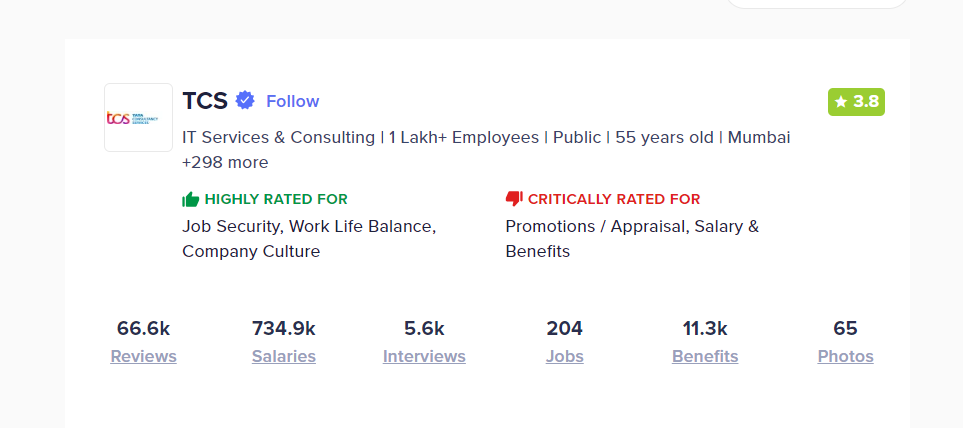

In [41]:
# The website is denying the access:

webpage = 'https://www.ambitionbox.com/list-of-companies?page=1'
print(requests.get(webpage))
print(requests.get(webpage).text)

<Response [403]>
<HTML><HEAD>
<TITLE>Access Denied</TITLE>
</HEAD><BODY>
<H1>Access Denied</H1>
 
You don't have permission to access "http&#58;&#47;&#47;www&#46;ambitionbox&#46;com&#47;list&#45;of&#45;companies&#63;" on this server.<P>
Reference&#32;&#35;18&#46;2fd70b17&#46;1698045324&#46;66410fa
</BODY>
</HTML>



Headers is used in the below code which is a part of the HTTP request headers that are sent when making a request to a website. In this code, it is specified as a "User-Agent" header. The "User-Agent" header is used to inform the web server about the client making the request, typically a web browser or a script. By providing a User-Agent header that mimics a common web browser, this helps to sometimes bypass restrictions or blocks that a website may impose on web scraping bots or non-browser requests.

In [42]:
# Create an empty list to store DataFrames
dataframes = []

for j in range(1, 550):
    headers = {
        "User-Agent": "Mozilla/5.0 (Windows NT 6.3; Win64; x64) Apple WeKit /537.36(KHTML, like Gecko) Chrome/80.0.3987.162 Safari/537.36"
    }
    webpage_final = requests.get(f'https://www.ambitionbox.com/list-of-companies?page={j}', headers=headers).text
    soup_all = BeautifulSoup(webpage_final, 'lxml')
    company_final_data = soup_all.find_all('div', class_='companyCardWrapper')

    company_name_all = []
    company_rating_all = []
    company_basic_description_all = []
    company_review_count_all = []

    for i in company_final_data:
        try:
            company_name_all.append(i.find('h2', {'class': 'companyCardWrapper__companyName'}).text.strip())
        except:
            company_name_all.append(np.nan)
        try:
            company_rating_all.append(i.find('span', {'class': 'companyCardWrapper__companyRatingValue'}).text.strip())
        except:
            company_rating_all.append(np.nan)
        try:
            company_basic_description_all.append(i.find('span', {'class': 'companyCardWrapper__interLinking'}).text.strip())
        except:
            company_basic_description_all.append(np.nan)
        try:
            company_review_count_all.append(i.find('span', {'class': 'companyCardWrapper__ActionCount'}).text.strip())
        except:
            company_review_count_all.append(np.nan)

    df_all = pd.DataFrame({'Company': company_name_all, 'Company_Rating': company_rating_all,
                           'Company_description': company_basic_description_all, 'Company_ReviewCount': company_review_count_all})

    # Append the DataFrame to the list
    dataframes.append(df_all)

# Concatenate the list of DataFrames into a single DataFrame
final_table = pd.concat(dataframes, ignore_index=True)


In [43]:
# Here is the final table that contains the required data:

final_table

,Company,Company_Rating,Company_description,Company_ReviewCount
0,TCS,3.8,IT Services & Consulting | 1 Lakh+ Employees |...,66.6k
1,Accenture,4.1,IT Services & Consulting | 1 Lakh+ Employees |...,42.5k
2,Cognizant,3.9,IT Services & Consulting | 1 Lakh+ Employees |...,38.4k
3,Wipro,3.8,IT Services & Consulting | 1 Lakh+ Employees |...,35.4k
4,ICICI Bank,4.0,Banking | 1 Lakh+ Employees | Public | 29 year...,30.9k
5,HDFC Bank,3.9,Banking | 1 Lakh+ Employees | Public | 29 year...,30.6k
6,Infosys,3.9,IT Services & Consulting | 1 Lakh+ Employees |...,29.1k
7,Capgemini,3.8,IT Services & Consulting | 1 Lakh+ Employees |...,27k
8,Tech Mahindra,3.7,IT Services & Consulting | 1 Lakh+ Employees |...,25.3k
9,HCLTech,3.7,IT Services & Consulting | 1 Lakh+ Employees |...,24.8k


In [269]:
# To extract the domain from the column Company_description.

def domain(data):
    try:
        for i in data.split('|')[0].split()[0]:
            if i[0] in alphabets:
                return data.split('|')[0]
            else:
                return np.nan
    except:
        return np.nan

In [270]:
# To extract the number of employees from the column Company_description.

def no_of_employees(data):
    try:
        for i in data.split('|')[1].split()[0]:
            if i[0] not in alphabets:
                return data.split('|')[1]
            else:
                return np.nan
    except:
        return np.nan

In [271]:
# To extract the number of employees from the column Company_description.

def no_of_employees1(data):
    try:
        for i in data.split('|')[0].split()[0]:
            if i[0] not in alphabets:
                return data.split('|')[0]
            else:
                return np.nan
    except:
        return np.nan

In [272]:
# To extract the company type from the column Company_description.

def company_type(data):
    try:
        for i in data.split('|')[2].split()[0]:
            if i[0] in alphabets:
                return data.split('|')[2]
            else:
                return np.nan
    except:
        return np.nan

In [273]:
# To extract the company type from the column Company_description.
def company_type1(data):
    try:
        for i in data.split('|')[1].split()[0]:
            if i[0] in alphabets:
                return data.split('|')[1]
            else:
                return np.nan
    except:
        return np.nan

In [274]:
# To extract the company age from the column Company_description.

def company_age(data):
    try:
        for i in data.split('|')[3].split()[0]:
            if i[0] not in alphabets:
                return data.split('|')[3].split()[0]
            else:
                return np.nan
    except:
        return np.nan

In [275]:
# To extract the company age from the column Company_description.

def company_age1(data):
    try:
        for i in data.split('|')[2].split()[0]:
            if i[0] not in alphabets:
                return data.split('|')[2].split()[0]
            else:
                return np.nan
    except:
        return np.nan

In [276]:
# To extract the company Head quarters from the column Company_description.

def company_HQ(data):
    try:
        return ' '.join(data.split('|')[-1].split()[0:2])
    except:
        return np.nan

Applying the abive functions to the table toobtain the respective data:

In [277]:
df1 = final_table.copy()

In [278]:
df1['Company_Domain'] = df1['Company_description'].apply(domain)

In [279]:
df1['No_of_Employees'] = df1['Company_description'].apply(no_of_employees)

In [280]:
df1['No_of_Employees1'] = df1['Company_description'].apply(no_of_employees1)

In [281]:
df1['Company_Sector'] = df1['Company_description'].apply(company_type)

In [282]:
df1['Company_Sector1'] = df1['Company_description'].apply(company_type1)

In [283]:
df1['Company_Age_in_Years'] = df1['Company_description'].apply(company_age)

In [284]:
df1['Company_Age_in_Years1'] = df1['Company_description'].apply(company_age1)

In [285]:
df1['Company_HQ and branches'] = df1['Company_description'].apply(company_HQ)

In [288]:
df1['Company_Age_in_Years'] = df1['Company_Age_in_Years'].fillna('')
df1['Company_Age_in_Years1'] = df1['Company_Age_in_Years1'].fillna('')
df1['Company_Age_in_Yrs'] = df1['Company_Age_in_Years'] + df1['Company_Age_in_Years1']

In [289]:
df1['Company_Sector'] = df1['Company_Sector'].fillna('')
df1['Company_Sector1'] = df1['Company_Sector1'].fillna('')
df1['Company_sector'] = df1['Company_Sector'] + df1['Company_Sector1']

In [290]:
df1['Company_sector'] = np.where(df1['Company_sector'] == '', np.nan,df1['Company_sector'])

In [291]:
df1['No_of_Employees'] = df1['No_of_Employees'].fillna('')
df1['No_of_Employees1'] = df1['No_of_Employees1'].fillna('')
df1['No_of_employees'] = df1['No_of_Employees'] + df1['No_of_Employees1']

In [293]:
df1 = df1[['Company', 'Company_Domain', 'No_of_employees', 'Company_sector', 'Company_Age_in_Yrs', 'Company_HQ and branches', 
          'Company_Rating', 'Company_ReviewCount']]

In [294]:
df1

,Company,Company_Domain,No_of_employees,Company_sector,Company_Age_in_Yrs,Company_HQ and branches,Company_Rating,Company_ReviewCount
0,TCS,IT Services & Consulting,1 Lakh+ Employees,Public,55,Mumbai +298,3.8,66.6k
1,Accenture,IT Services & Consulting,1 Lakh+ Employees,Public,34,Dublin +148,4.1,42.5k
2,Cognizant,IT Services & Consulting,1 Lakh+ Employees,Forbes Global 2000,29,Teaneck. New,3.9,38.4k
3,Wipro,IT Services & Consulting,1 Lakh+ Employees,Public,78,Bangalore/Bengaluru +253,3.8,35.4k
4,ICICI Bank,Banking,1 Lakh+ Employees,Public,29,Mumbai +1215,4.0,30.9k
5,HDFC Bank,Banking,1 Lakh+ Employees,Public,29,Mumbai +1451,3.9,30.6k
6,Infosys,IT Services & Consulting,1 Lakh+ Employees,Public,42,Bengaluru/Bangalore +148,3.9,29.1k
7,Capgemini,IT Services & Consulting,1 Lakh+ Employees,Public,56,Paris +100,3.8,27k
8,Tech Mahindra,IT Services & Consulting,1 Lakh+ Employees,Public,37,Pune +240,3.7,25.3k
9,HCLTech,IT Services & Consulting,1 Lakh+ Employees,Public,32,Noida +160,3.7,24.8k


In [295]:
df1[df1['No_of_employees'] == '']

,Company,Company_Domain,No_of_employees,Company_sector,Company_Age_in_Yrs,Company_HQ and branches,Company_Rating,Company_ReviewCount
24,Reliance Industries,Oil & Gas,,Public,46,Kota +608,4.0,12.2k
345,Samsung Electronics,Noida +187 more,,NaN,,Noida +187,4.0,1.6k
397,suzuki motor gujarat,Fortune India 500,,Becharaji +68 more,,Becharaji +68,4.3,1.4k
455,PHN Technology,Pune +29 more,,NaN,,Pune +29,4.6,1.3k
466,KPMG Global Services,Bengaluru/Bangalore +21 more,,NaN,,Bengaluru/Bangalore +21,3.8,1.3k
605,ZF Commercial Vehicle Control Systems,Auto Components,,Chennai +33 more,,Chennai +33,4.0,1k
627,CGI Information Systems And Management Consult...,Bengaluru/Bangalore +9 more,,NaN,,Bengaluru/Bangalore +9,4.2,1k
639,GE Vernova,Noida +68 more,,NaN,,Noida +68,4.2,979
827,United Alliance Technology,IT Services & Consulting,,Pune +9 more,,Pune +9,4.9,776
903,Fluor Corporation,Forbes Global 2000,,Gurgaon/Gurugram +20 more,,Gurgaon/Gurugram +20,4.3,708


In [230]:
df1[df1['Company_Age_in_Yrs'] == '']

,Company,Company_Domain,No_of_employees,Company_sector,Company_Age_in_Yrs,Company_HQ and branches,Company_Rating,Company_ReviewCount
73,Amazon Development Centre India,Internet,10k-50k Employees,Hyderabad/Secunderabad +58 more,,Hyderabad/Secunderabad +58,4.2,4.5k
92,Capgemini Technology Services India Limited,IT Services & Consulting,1 Lakh+ Employees,Bengaluru/Bangalore +34 more,,Bengaluru/Bangalore +34,4.0,4k
121,SBI Cards & Payment Services,NaN,25 years old 1k-5k Employees,Gurgaon/Gurugram +305 more,,Gurgaon/Gurugram +305,3.7,3.2k
205,NatWest Group,Banking,10k-50k Employees,Forbes Global 2000,,Gurgaon/Gurugram +21,4.1,2.3k
228,Carelon Global Solutions,IT Services & Consulting,5k-10k Employees,Hyderabad/Secunderabad +9 more,,Hyderabad/Secunderabad +9,4.0,2.2k
248,ArcelorMittal Nippon Steel,Iron & Steel,5k-10k Employees,Conglomerate,,Surat +60,4.0,2.1k
279,Capgemini Engineering,NaN,10k-50k Employees,Gurgaon/Gurugram +18 more,,Gurgaon/Gurugram +18,3.6,1.9k
282,Bajaj Allianz General Insurance,Insurance,5k-10k Employees,Pune +189 more,,Pune +189,4.0,1.9k
326,Nokia Networks,Hardware & Networking,501-1k Employees,Chennai +81 more,,Chennai +81,4.3,1.7k
345,Samsung Electronics,Noida +187 more,,NaN,,Noida +187,4.0,1.6k


In [296]:
df1['No_of_employees'] = np.where(df1['No_of_employees'] == '', np.nan,df1['No_of_employees'])
df1['Company_Age_in_Yrs'] = np.where(df1['Company_Age_in_Yrs'] == '', np.nan,df1['Company_Age_in_Yrs'])

In [298]:
df1['Company_sector'].value_counts()

Company_sector
 Public                                              1767
 Startup                                              350
 Forbes Global 2000                                   282
 Fortune India 500                                    116
 Conglomerate                                         103
 Indian Unicorn                                        77
 Central                                               52
 State                                                 25
 Chennai +3 more                                        8
 Hyderabad/Secunderabad +3 more                         6
 New Delhi +18 more                                     6
 Bengaluru/Bangalore +2 more                            6
 Noida +5 more                                          6
 Hyderabad/Secunderabad                                 5
 Chennai +5 more                                        5
 Bengaluru/Bangalore +5 more                            5
 Mumbai +8 more                                         5

In [300]:
# Filtering further

valid_values = [' Public ', ' Startup ', ' Forbes Global 2000 ', ' Fortune India 500 ', ' Conglomerate ', ' Indian Unicorn ', ' Central ', ' State ', ' MNC ']

df1['Company_sector'] = df1['Company_sector'].apply(lambda x: x if x in valid_values else np.nan)                                        

In [301]:
df1['Company_sector'].value_counts()

Company_sector
 Public                 1767
 Startup                 350
 Forbes Global 2000      282
 Fortune India 500       116
 Conglomerate            103
 Indian Unicorn           77
 Central                  52
 State                    25
 MNC                       5
Name: count, dtype: int64

In [303]:
df1

,Company,Company_Domain,No_of_employees,Company_sector,Company_Age_in_Yrs,Company_HQ and branches,Company_Rating,Company_ReviewCount
0,TCS,IT Services & Consulting,1 Lakh+ Employees,Public,55,Mumbai +298,3.8,66.6k
1,Accenture,IT Services & Consulting,1 Lakh+ Employees,Public,34,Dublin +148,4.1,42.5k
2,Cognizant,IT Services & Consulting,1 Lakh+ Employees,Forbes Global 2000,29,Teaneck. New,3.9,38.4k
3,Wipro,IT Services & Consulting,1 Lakh+ Employees,Public,78,Bangalore/Bengaluru +253,3.8,35.4k
4,ICICI Bank,Banking,1 Lakh+ Employees,Public,29,Mumbai +1215,4.0,30.9k
5,HDFC Bank,Banking,1 Lakh+ Employees,Public,29,Mumbai +1451,3.9,30.6k
6,Infosys,IT Services & Consulting,1 Lakh+ Employees,Public,42,Bengaluru/Bangalore +148,3.9,29.1k
7,Capgemini,IT Services & Consulting,1 Lakh+ Employees,Public,56,Paris +100,3.8,27k
8,Tech Mahindra,IT Services & Consulting,1 Lakh+ Employees,Public,37,Pune +240,3.7,25.3k
9,HCLTech,IT Services & Consulting,1 Lakh+ Employees,Public,32,Noida +160,3.7,24.8k


The above table gives the entire information about the companies listed on the Ambition Box Website.